In [2]:
!pip install -q pillow numpy datasets pyarrow huggingface-hub matplotlib tqdm opencv-python flash_attn einops timm shapely

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 51.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 485.4/485.4 kB 29.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 118.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 90.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 35.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.8 MB/s eta 0:00:0

# Imports and setup

In [32]:
import os
import json
import torch
import numpy as np
from pathlib import Path
from PIL import Image as PILImage, ImageDraw
from IPython.display import Image as IPImage, display
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import logging
import random
from datetime import datetime
from transformers import AutoProcessor, AutoModelForCausalLM
from difflib import get_close_matches

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(name)s - %(levelname)s - %(message)s',
    datefmt='%Y-%m-%d %H:%M:%S'
)
logger = logging.getLogger('inference')

# Define colormap for visualizations
COLORMAP = [
    'blue', 'orange', 'green', 'purple', 'red'
]

# Define instrument labels
INSTRUMENT_LABELS = [
    "NEEDLE HOLDER MAYO HEGAR 7\"",
    "LANE DISSECTING FORCEP 2 IN 3 TOOTHED 5.5\"",
    "LAHEY FORCEP",
    "MAYO SCISSOR STRAIGHT GOLD HANDLED 5.5\"",
    "FORCEP LITTLEWOOD"
]

# Global variables for model and processor

In [33]:
model = None
processor = None
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Helper

In [34]:
def load_model(model_id='microsoft/Florence-2-large'):
    """Load model and processor"""
    global model, processor, device

    logger.info(f"Using device: {device}")
    logger.info(f"Loading model: {model_id}")

    model = AutoModelForCausalLM.from_pretrained(
        model_id,
        trust_remote_code=True,
        torch_dtype='auto'
    ).eval().to(device)

    processor = AutoProcessor.from_pretrained(
        model_id,
        trust_remote_code=True
    )
    logger.info("Model and processor loaded successfully")

def clean_prediction_text(text):
    """Clean prediction text by removing special tokens"""
    return text.replace("</s>", "").replace("<s>", "").replace("<pad>", "")

def map_to_instrument_labels(od_results):
    """Map generic detection labels to specific instrument labels based on similarity"""
    # Create a copy of results to modify
    mapped_results = od_results.copy()

    # Try to map each detected label to our known instrument labels
    for i, label in enumerate(od_results['labels']):
        # Try to find the closest match among our instrument labels
        matches = get_close_matches(label.upper(), [l.upper() for l in INSTRUMENT_LABELS], n=1, cutoff=0.3)

        if matches:
            # Find the original case of the matched label
            match_idx = [l.upper() for l in INSTRUMENT_LABELS].index(matches[0])
            mapped_results['labels'][i] = INSTRUMENT_LABELS[match_idx]
            logger.info(f"Mapped '{label}' to '{INSTRUMENT_LABELS[match_idx]}'")
        else:
            logger.info(f"No match found for '{label}', keeping original")

    return mapped_results

In [35]:
def run_inference(image, task_prompt, text_input=None):
    """Run inference on a single image"""
    global model, processor

    if model is None or processor is None:
        raise ValueError("Model and processor not loaded. Call load_model() first.")

    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input

    logger.info(f"Running inference with prompt: {prompt}")

    # Prepare inputs
    inputs = processor(
        text=prompt,
        images=image,
        return_tensors="pt"
    ).to(device)

    # Generate output
    with torch.no_grad():
        generated_ids = model.generate(
            input_ids=inputs["input_ids"],
            pixel_values=inputs["pixel_values"],
            max_new_tokens=1024,
            early_stopping=False,
            do_sample=False,
            num_beams=3,
        )

    # Decode and post-process
    generated_text = processor.batch_decode(
        generated_ids,
        skip_special_tokens=False
    )[0]

    # Clean prediction text
    cleaned_text = clean_prediction_text(generated_text)

    # Post-process the generated text
    parsed_answer = processor.post_process_generation(
        cleaned_text,
        task=task_prompt,
        image_size=(image.width, image.height)
    )

    # For object detection, map to our specific instrument labels
    if task_prompt == '<OD>' and parsed_answer.get('<OD>'):
        parsed_answer['<OD>'] = map_to_instrument_labels(parsed_answer['<OD>'])

    return parsed_answer, generated_text



## Visualise object detection

In [36]:
def visualize_object_detection(image, prediction, output_path=None):
    """Visualize object detection results"""
    # Create figure and axes
    fig, ax = plt.subplots(figsize=(10, 10))

    # Display the image
    ax.imshow(image)

    # Plot each bounding box
    for bbox, label in zip(prediction['bboxes'], prediction['labels']):
        # Unpack the bounding box coordinates
        x1, y1, x2, y2 = bbox

        # Create a Rectangle patch
        rect = patches.Rectangle(
            (x1, y1),
            x2-x1,
            y2-y1,
            linewidth=2,
            edgecolor='r',
            facecolor='none'
        )

        # Add the rectangle to the Axes
        ax.add_patch(rect)

        # Annotate the label
        plt.text(
            x1,
            y1-5,
            label,
            color='white',
            fontsize=12,
            bbox=dict(facecolor='red', alpha=0.7)
        )

    # Remove the axis ticks and labels
    ax.axis('off')

    # Save if output path is provided
    if output_path:
        plt.savefig(output_path, bbox_inches='tight', dpi=200)
        logger.info(f"Saved object detection visualization to {output_path}")

    plt.close(fig)
    return fig



## Visualise  segmentation

In [37]:
def visualize_segmentation(image, prediction, fill_mask=True, output_path=None, alpha=0.7):
    """
    Visualize segmentation results.

    Args:
        image: PIL Image to visualize on
        prediction: Prediction dictionary with polygons and labels
        fill_mask: Whether to fill the polygons with color
        output_path: Path to save the visualization
        alpha: Transparency of the fill (0.0-1.0)

    Returns:
        PIL Image with visualization
    """
    # Make a copy of the image to avoid modifying the original
    output_image = image.copy()
    draw = ImageDraw.Draw(output_image)

    # Iterate over polygons and labels
    for polygons, label in zip(prediction['polygons'], prediction['labels']):
        color = random.choice(COLORMAP)
        fill_color = random.choice(COLORMAP) if fill_mask else None

        # If alpha < 1.0 and we're filling, convert color to RGBA with alpha
        if fill_mask and alpha < 1.0:
            # Convert color name to RGB
            from matplotlib.colors import to_rgb
            r, g, b = to_rgb(color)
            r_int, g_int, b_int = int(r*255), int(g*255), int(b*255)

            # Apply mask as a new image with transparency
            mask_img = PILImage.new('RGBA', output_image.size, (0, 0, 0, 0))
            mask_draw = ImageDraw.Draw(mask_img)

            for _polygon in polygons:
                _polygon = np.array(_polygon).reshape(-1, 2)
                if len(_polygon) < 3:
                    logger.warning(f'Invalid polygon: {_polygon}')
                    continue

                _polygon = _polygon.reshape(-1).tolist()
                mask_draw.polygon(_polygon, fill=(r_int, g_int, b_int, int(alpha*255)), outline=color)

            # Convert output image to RGBA if it's not already
            if output_image.mode != 'RGBA':
                output_image = output_image.convert('RGBA')

            # Paste mask on top of the output image
            output_image = PILImage.alpha_composite(output_image, mask_img)

            # Add label text (need to use draw from mask_img)
            for _polygon in polygons:
                _polygon = np.array(_polygon).reshape(-1, 2)
                if len(_polygon) < 3:
                    continue
                mask_draw.text(
                    (_polygon[0][0] + 8, _polygon[0][1] + 2),
                    label,
                    fill="white"
                )

            # Draw is no longer valid for output_image as we composed a new image
            draw = ImageDraw.Draw(output_image)
        else:
            # Standard approach without transparency
            for _polygon in polygons:
                _polygon = np.array(_polygon).reshape(-1, 2)
                if len(_polygon) < 3:
                    logger.warning(f'Invalid polygon: {_polygon}')
                    continue

                _polygon = _polygon.reshape(-1).tolist()

                # Draw the polygon
                if fill_mask:
                    draw.polygon(_polygon, outline=color, fill=fill_color)
                else:
                    draw.polygon(_polygon, outline=color)

                # Draw the label text
                draw.text(
                    (_polygon[0] + 8, _polygon[1] + 2),
                    label,
                    fill="white"
                )

    # Save if output path is provided
    if output_path:
        # Convert to RGB for saving if it's RGBA (some formats don't support alpha)
        if output_image.mode == 'RGBA' and isinstance(output_path, Path) and output_path.suffix.lower() in ['.jpg', '.jpeg']:
            # Create a white background
            background = PILImage.new('RGB', output_image.size, (255, 255, 255))
            # Paste using alpha channel as mask
            background.paste(output_image, mask=output_image.split()[3])
            background.save(output_path)
        else:
            output_image.save(output_path)
        logger.info(f"Saved segmentation visualization to {output_path}")

    return output_image

## Process Image

In [38]:
def process_image(image_path, output_dir='outputs', od_prompt=True, seg_prompt=True, seg_text=None):
    """Process a single image with both object detection and segmentation"""
    try:
        # Create output directory
        output_dir = Path(output_dir)
        output_dir.mkdir(exist_ok=True, parents=True)

        # Load image
        image_path = Path(image_path)
        logger.info(f"Processing image: {image_path}")
        image = PILImage.open(image_path).convert("RGB")

        results = {}

        # Run object detection if requested
        if od_prompt:
            task_prompt = '<OD>'
            od_results, od_raw_text = run_inference(image, task_prompt)
            results['object_detection'] = {
                'results': od_results,
                'raw_text': od_raw_text
            }

            # Print detected instruments
            if '<OD>' in od_results and 'labels' in od_results['<OD>']:
                detected_labels = od_results['<OD>']['labels']
                logger.info(f"Detected instruments: {', '.join(detected_labels)}")

            # Visualize and save
            od_output_path = output_dir / f"{image_path.stem}_od.png"
            visualize_object_detection(
                image,
                od_results['<OD>'],
                output_path=od_output_path
            )
            logger.info(f"Object detection output saved to: {od_output_path}")

        # Run segmentation if requested
        if seg_prompt:
            task_prompt = '<REFERRING_EXPRESSION_SEGMENTATION>'
            # If no segmentation text is provided, use "surgical instrument" as default
            if not seg_text:
                seg_text = "surgical instrument"
            seg_results, seg_raw_text = run_inference(
                image,
                task_prompt,
                text_input=seg_text
            )
            results['segmentation'] = {
                'results': seg_results,
                'raw_text': seg_raw_text
            }

            # Visualize and save
            seg_output_path = output_dir / f"{image_path.stem}_seg.png"
            seg_viz = visualize_segmentation(
                image,
                seg_results['<REFERRING_EXPRESSION_SEGMENTATION>'],
                output_path=seg_output_path
            )
            logger.info(f"Segmentation output saved to: {seg_output_path}")

        # Save combined visualization if both OD and SEG were run
        if od_prompt and seg_prompt and '<OD>' in od_results and '<REFERRING_EXPRESSION_SEGMENTATION>' in seg_results:
            try:
                combined_output_path = output_dir / f"{image_path.stem}_combined.png"
                # Create a copy of the image for combined visualization
                combined_image = image.copy()

                # Add segmentation
                combined_image = visualize_segmentation(
                    combined_image,
                    seg_results['<REFERRING_EXPRESSION_SEGMENTATION>'],
                    fill_mask=True,
                    alpha=0.4  # Semi-transparent mask
                )

                # Convert to matplotlib figure to add bounding boxes
                fig, ax = plt.subplots(figsize=(10, 10))
                ax.imshow(combined_image)

                # Add bounding boxes
                for bbox, label in zip(od_results['<OD>']['bboxes'], od_results['<OD>']['labels']):
                    x1, y1, x2, y2 = bbox
                    rect = patches.Rectangle(
                        (x1, y1), x2-x1, y2-y1,
                        linewidth=2, edgecolor='r', facecolor='none'
                    )
                    ax.add_patch(rect)
                    ax.text(
                        x1, y1-5, label,
                        color='white', fontsize=12,
                        bbox=dict(facecolor='red', alpha=0.7)
                    )

                ax.axis('off')
                plt.tight_layout()
                plt.savefig(combined_output_path, bbox_inches='tight', dpi=200)
                plt.close(fig)

                logger.info(f"Combined visualization saved to: {combined_output_path}")
            except Exception as e:
                logger.error(f"Error creating combined visualization: {str(e)}")

        # Save results to JSON
        results_path = output_dir / f"{image_path.stem}_results.json"

        # Convert results to serializable format
        serializable_results = {}
        for task, task_results in results.items():
            serializable_results[task] = {
                'raw_text': task_results['raw_text']
            }

            # Handle specific task outputs
            if task == 'object_detection':
                od_data = task_results['results']['<OD>']
                serializable_results[task]['bboxes'] = od_data['bboxes']
                serializable_results[task]['labels'] = od_data['labels']

            elif task == 'segmentation':
                seg_data = task_results['results']['<REFERRING_EXPRESSION_SEGMENTATION>']
                # Convert polygons to serializable format
                polygons = []
                for polygon_set in seg_data['polygons']:
                    serializable_polygons = []
                    for polygon in polygon_set:
                        serializable_polygons.append(polygon)
                    polygons.append(serializable_polygons)

                serializable_results[task]['polygons'] = polygons
                serializable_results[task]['labels'] = seg_data['labels']

        # Save to JSON
        with open(results_path, 'w') as f:
            json.dump(serializable_results, f, indent=2)

        logger.info(f"Results saved to {results_path}")
        return results

    except Exception as e:
        logger.error(f"Error processing {image_path}: {str(e)}")
        return None

# Example usage

## Set the model and output path

In [39]:
MODEL_ID = "Source82/SIM-Model"  # or path to your fine-tuned model

## Load the model (only need to do this once)

In [40]:
load_model(MODEL_ID)

## Example 1: Object detection and segmentation

In [ ]:
OUTPUT_DIR = "test/results/output1"
INSTRUMENT_LABEL = "NEEDLE HOLDER MAYO HEGAR 7\""

In [56]:
image_path = "/content/2023_04_17T11_08_44_608699_top.png"  # Replace with actual path
results = process_image(
    image_path,
    output_dir=OUTPUT_DIR,
    od_prompt=True,
    seg_prompt=True,
    seg_text=INSTRUMENT_LABEL
)

Object Detection Results:


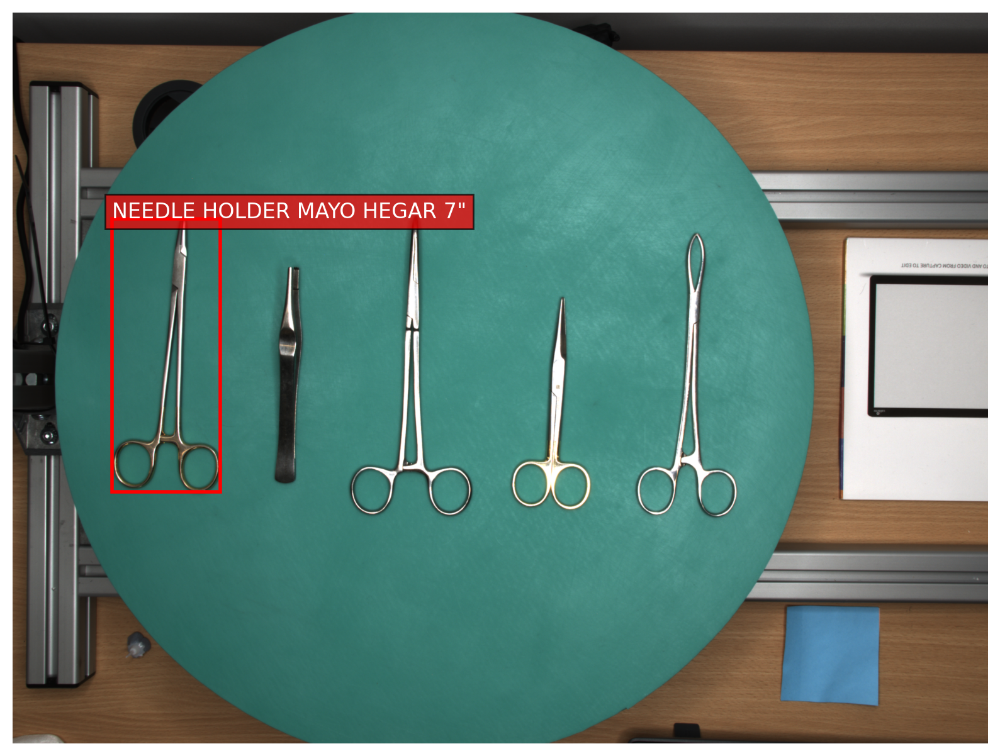

In [57]:
# Display results
from IPython.display import Image, display
print("Object Detection Results:")
display(IPImage(f"{OUTPUT_DIR}/{Path(image_path).stem}_od.png"))

Segmentation Results:


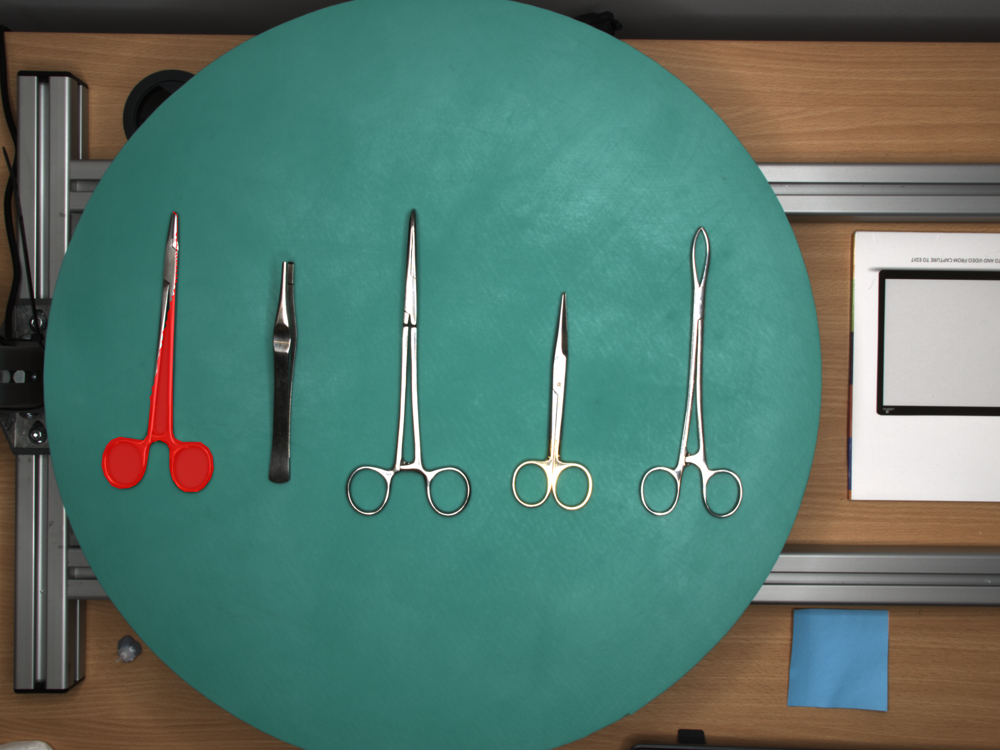

In [58]:
print("Segmentation Results:")
display(IPImage(f"{OUTPUT_DIR}/{Path(image_path).stem}_seg.png"))

Combined Results:


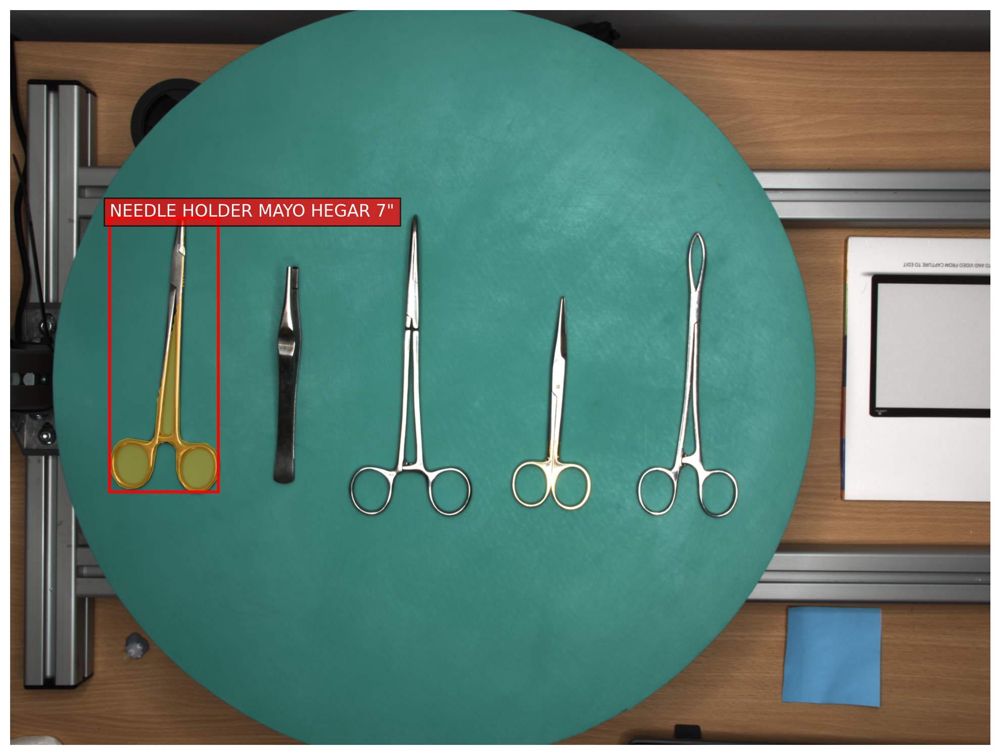

In [59]:
print("Combined Results:")
display(IPImage(f"{OUTPUT_DIR}/{Path(image_path).stem}_combined.png"))

## Example 2: Segmentation only example

In [ ]:
OUTPUT_DIR = "test/results/output2"
INSTRUMENT_LABEL = "LAHEY FORCEP"

image_path = "/content/2023_04_17T11_08_44_608699_top.png"  # Replace with actual path
results = process_image(
    image_path,
    output_dir=OUTPUT_DIR,
    od_prompt=False,
    seg_prompt=True,
    seg_text=INSTRUMENT_LABEL
)

Segmentation Results:


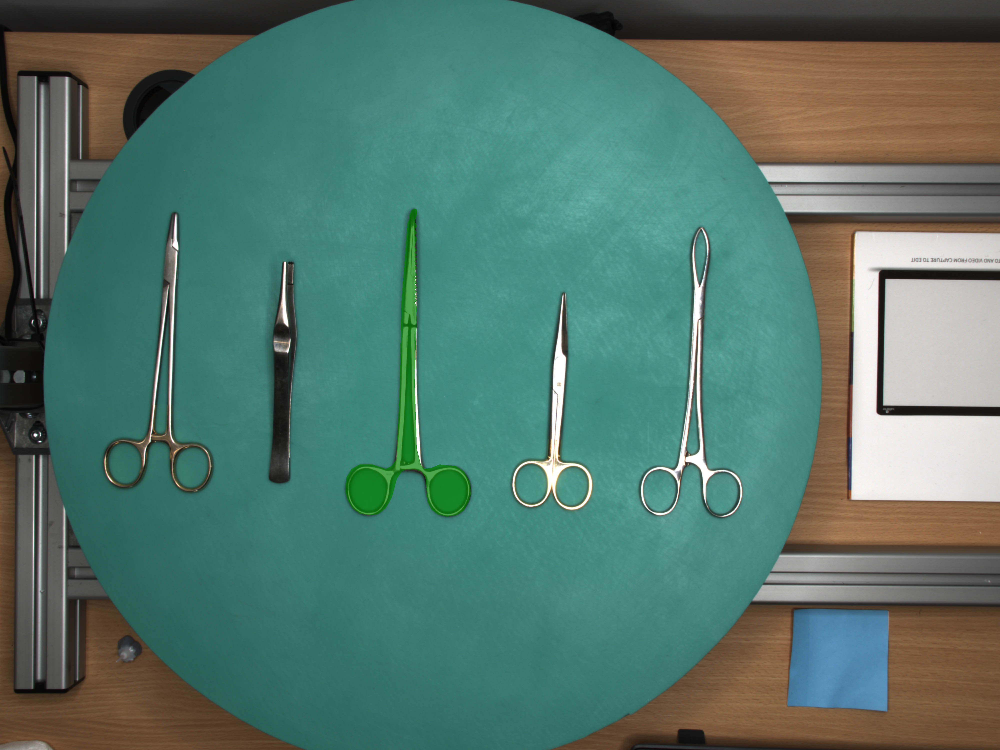

In [61]:
print("Segmentation Results:")
display(IPImage(f"{OUTPUT_DIR}/{Path(image_path).stem}_seg.png"))